# Notebook for model training

### Training Flow

Load Training Data:
- Load set of input data and label files
- Prefilter positive set only to rule out heavily-masked patches
- Create train/test set
- Define augmentation parameters

Train Model:
- Define model architecture
- Compile model
- Train and evaluate model
- Save model

In [25]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [26]:
from datetime import date
import os
import pickle
import sys

import pandas as pd
import io
from contextlib import redirect_stdout
import re
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
from tensorflow import keras
from tensorflow.keras.applications import MobileNet
from tensorflow.keras.models import Model

from keras.layers import Input, Dense, Flatten, Dropout, Conv2D
from keras.models import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tqdm.notebook import tqdm

parent_dir = os.path.split(os.getcwd())[0]
if parent_dir not in sys.path:
    sys.path.insert(0, parent_dir)

from scripts import dl_utils
from scripts import viz_tools
from scripts import models

## Open Data

In [27]:
resolution = 48

start_dates = ['2019-01-01']
end_dates = ['2020-01-01']
dates = [f'{sd}_{ed}' for sd,ed in zip(start_dates, end_dates)]

data_files = []
label_files = []
# for elem in os.listdir("C:/Users/raulp/Documents/Master/TFM/minig-detector-tfm/data/training_data/48_px"):
for elem in os.listdir("../data/training_data/48_px"):
    if "_labels.pkl" in elem:
        label_files.append(elem)
    elif ".pkl" in elem:
        data_files.append(elem)


patches = []
labels = []

data_dir = os.path.join('..', 'data', 'training_data', f"{resolution}_px")

for data, label in tqdm(zip(data_files, label_files), total=len(data_files)):
    with open(os.path.join(data_dir, data), 'rb') as f:
        data = pickle.load(f)
        for elem in data:
            #patch = dl_utils.pad_patch(elem, resolution)
            patches.append(elem)
    with open(os.path.join(data_dir, label), 'rb') as f:
        label = pickle.load(f)
        labels = np.concatenate((labels, label))

patches = np.array(patches)
positive_patches = patches[labels == 1]
negative_patches = patches[labels == 0]

print(len(patches), "samples loaded")
print(sum(labels == 1), "positive samples")
print(sum(labels == 0), "negative samples")

  0%|          | 0/15 [00:00<?, ?it/s]

2644 samples loaded
551 positive samples
2093 negative samples


  0%|          | 0/64 [00:00<?, ?it/s]

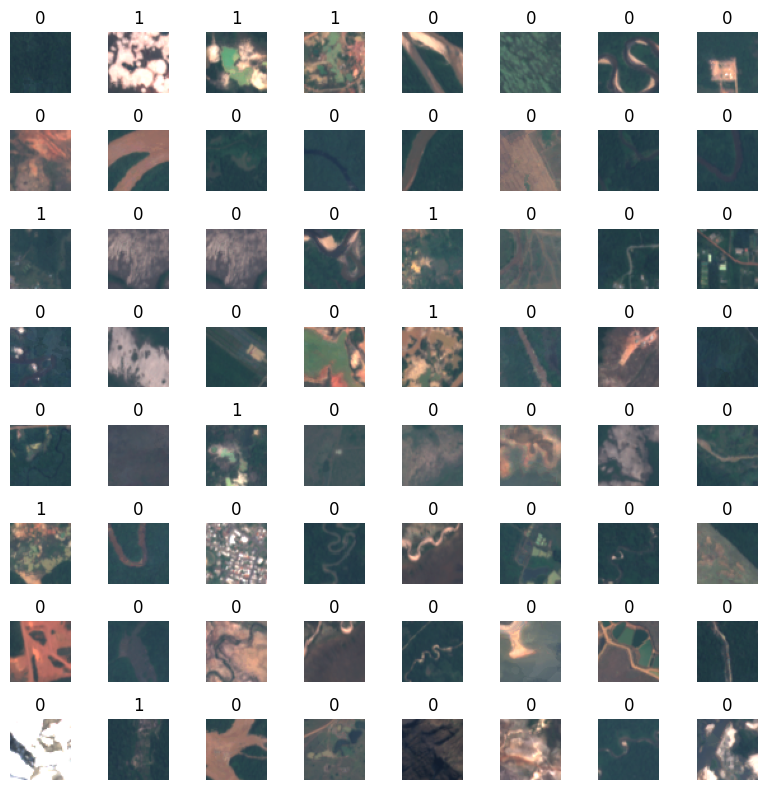

In [28]:
num_samples = 64
indices = np.random.randint(0, len(patches), num_samples)
viz_tools.plot_image_grid(patches[indices], labels=[int(label) for label in labels[indices]])

In [29]:
def filter_black(data, mask_limit=0.1, return_rejects=False):
    masked_fraction = np.array([np.sum(np.mean(patch, axis=-1) < 10) / np.size(np.mean(patch, axis=-1)) for patch in data])
    filtered_data = data[masked_fraction < mask_limit]
    print(f"{len(filtered_data) / len(data) :.1%} of data below brightness limit")
    if return_rejects:
        rejected_data = data[masked_fraction >= mask_limit]
        return filtered_data, rejected_data
    else:
        return filtered_data

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.7141666666666666].


100.0% of data below brightness limit


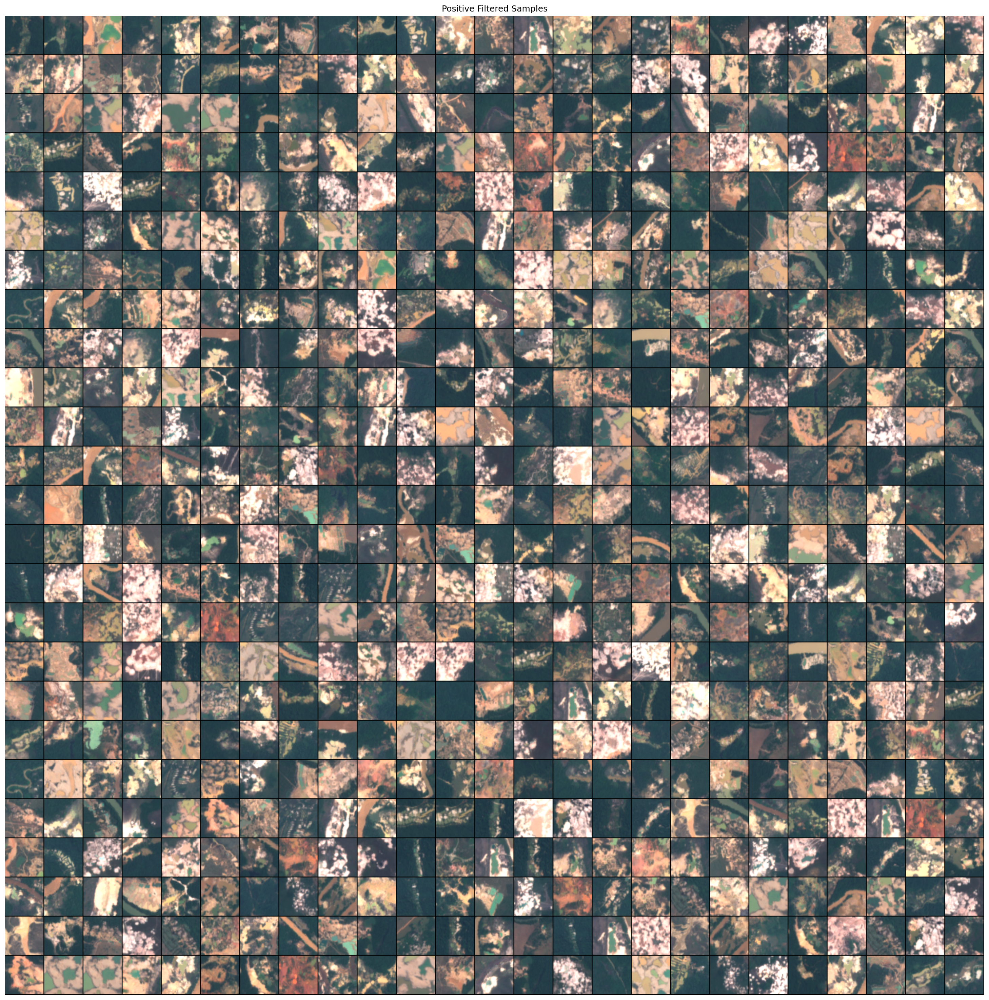

In [30]:
# Filter positive pixels that are masked beyond a threshold. Don't want to give positive examples of cloud-masked patches
filtered_positives, positive_rejects = filter_black(positive_patches, mask_limit = 0.1, return_rejects=True)
if len(positive_rejects) > 0:
    num_samples = 16**2
    if len(positive_rejects) < num_samples:
        num_samples = len(positive_rejects)
    indices = np.random.randint(0, len(positive_rejects), num_samples)
    viz_tools.plot_numpy_grid(positive_rejects[indices,:,:,3:0:-1] / 3000)
    plt.title("Positive Masked Rejects")
    plt.show()

num_samples = 25 ** 2
indices = np.random.randint(0, len(filtered_positives), num_samples)
fig = viz_tools.plot_numpy_grid(filtered_positives[indices,:,:,3:0:-1] / 3000)
plt.title('Positive Filtered Samples')
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..2.8356666666666666].


100.0% of data below brightness limit


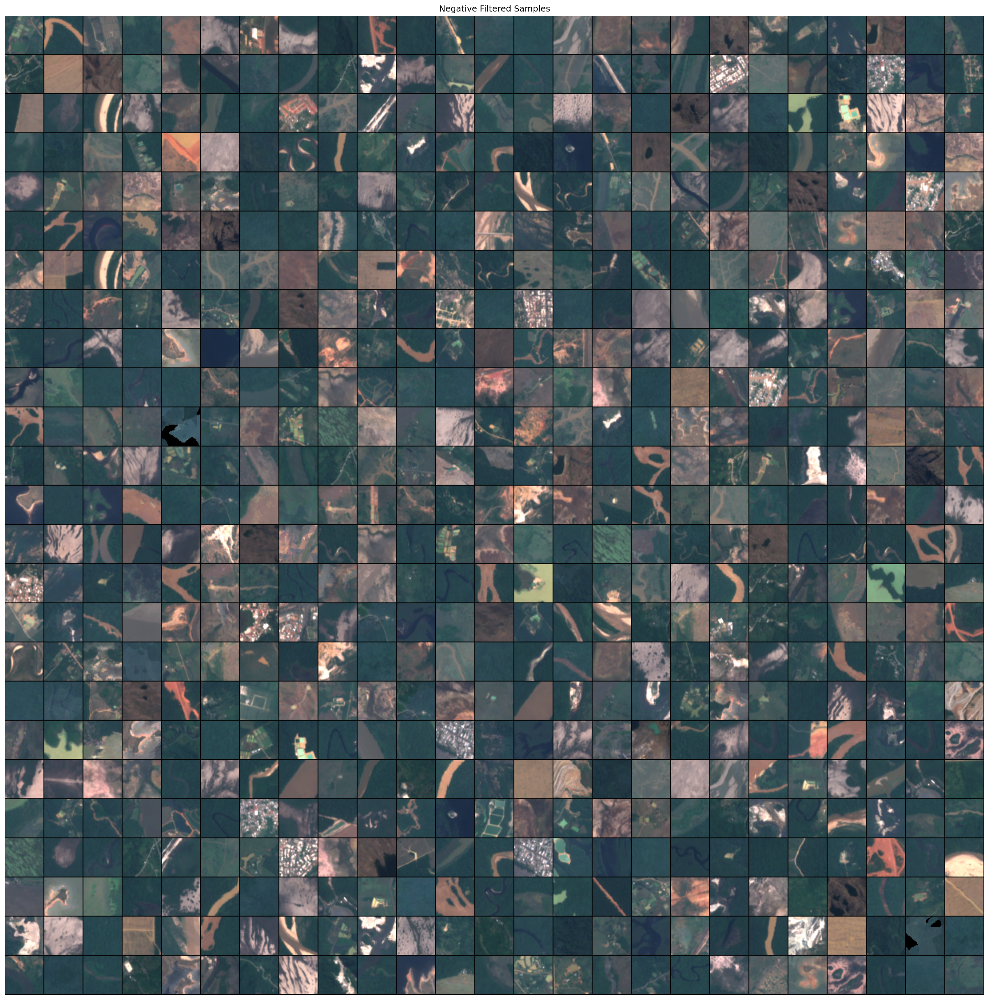

In [31]:
filtered_negatives, negative_rejects = filter_black(negative_patches, mask_limit = 0.6, return_rejects=True)
if len(negative_rejects) > 0:
    num_samples = 16**2
    if len(positive_rejects) < num_samples:
        num_samples = len(positive_rejects)
    indices = np.random.randint(0, len(negative_rejects), num_samples)
    viz_tools.plot_numpy_grid(negative_rejects[indices,:,:,3:0:-1] / 3000)
    plt.title("Negative Mask Rejects")
    plt.show()

num_samples = 25 ** 2
indices = np.random.randint(0, len(filtered_negatives), num_samples)
fig = viz_tools.plot_numpy_grid(filtered_negatives[indices,:,:,3:0:-1] / 3000)
plt.title('Negative Filtered Samples')
plt.show()

## Prepare Data for Training

In [32]:
#for RGBIR, x = normalize(np.copy(images[:,:,:,[1,2,3,8]]))
x = np.concatenate((filtered_negatives, filtered_positives))
y = np.concatenate((np.zeros(len(filtered_negatives)), np.ones(len(filtered_positives))))
x, y = shuffle(x, y, random_state=33)

## Data Augmentation
Augmentation is important to help the model train. These are parameters that generally worked, but there is certainly room for improvement.

Plot a set of images to give an example of augmented images

/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (2644, 48, 48, 12) (12 channels).
  warnings.warn(


  0%|          | 0/64 [00:00<?, ?it/s]

<Figure size 1800x1800 with 0 Axes>

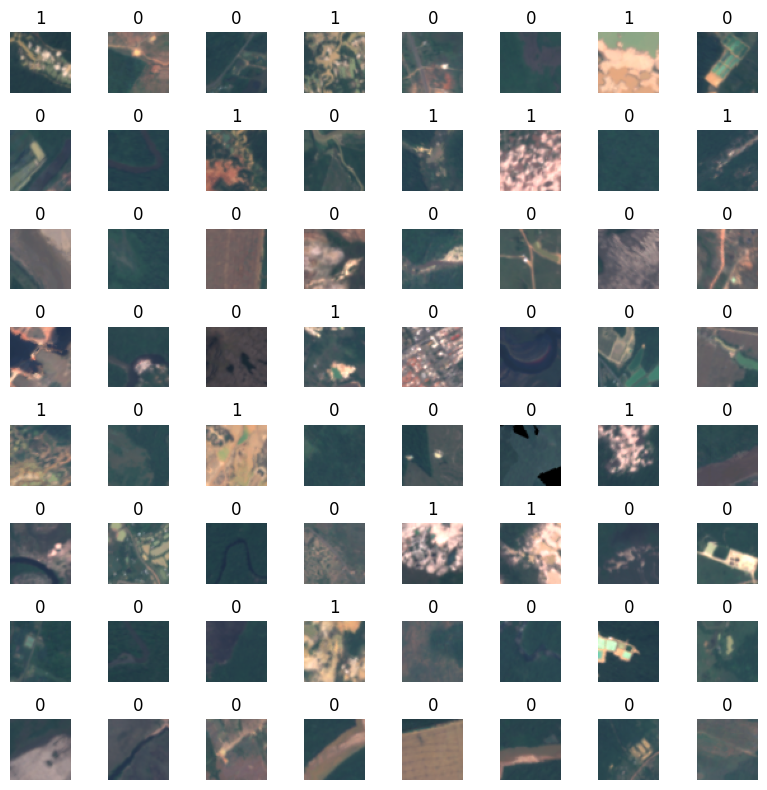

In [33]:
augmentation_parameters = {
    'featurewise_center': False,
    'rotation_range': 360,
    'width_shift_range': [0.9, 1.1],
    'height_shift_range': [0.9, 1.1],
    'shear_range': 10,
    'zoom_range': [0.9, 1.1],
    'vertical_flip': True,
    'horizontal_flip': True,
    # Fill options: "constant", "nearest", "reflect" or "wrap"
    'fill_mode': 'reflect'
}

datagen = ImageDataGenerator(**augmentation_parameters)


plt.figure(figsize=(12,12), facecolor=(1,1,1), dpi=150)
aug_img, aug_labels = datagen.flow(x, y, batch_size=64).next()
viz_tools.plot_image_grid(aug_img, labels=[int(l) for l in aug_labels], norm=True);


In [34]:
x_norm = np.clip(np.array(x.astype("float32") / 10000), 0, 1)

# Entrenamiento

## Balanceo de clases para el entrenamiento

In [35]:
# dataset_len = len(y)
# class_0 = len(y[y==0])
# class_1 = len(y[y==1])

# class_0_weighted = 2 - len(y[y==0]) / len(y)
# class_1_weighted = 2 - len(y[y==1]) / len(y)

# # add a weighted loss
# class_weighted = {0: class_0_weighted, 1: class_1_weighted}
# print(f"\nEl número de valores para la clase no mina es de {class_0} y para la clase mina {class_1}")
# print(f"\nPonemos peso a cada clase para tenerlo en cuenta en el entrenamiento {class_weighted}")

## Clases no balanceadas

In [36]:
# # add a weighted loss
# class_weight = {0: 1, 1: 1}

## Diccionario con todos los hiperparámetros editables

### Hiperparámetros para pruebas con test size del 20%

#### Clases balanceadas CON reduce_lr en callbacks

In [37]:
hiper_params_test1 = {"class_weight" : {0: 2 - len(y[y==0]) / len(y), 1: 2 - len(y[y==1]) / len(y)},
                      "batch_size" : 32, 
                      "epochs" : 160,
                      "define_callbacks" : ["reduce_lr", "early_stopping", "model_checkpoint"],
                      "patience_early_stopping" : 15,
                      "patience_reduce_lr" : 6,
                      "test_size" : 0.2
                     }

#### Clases balanceadas SIN reduce_lr en callbacks

In [38]:
hiper_params_test2 = {"class_weight" : {0: 2 - len(y[y==0]) / len(y), 1: 2 - len(y[y==1]) / len(y)},
                      "batch_size" : 32, 
                      "epochs" : 160,
                      "define_callbacks" : ["early_stopping", "model_checkpoint"],
                      "patience_early_stopping" : 15,
                      "patience_reduce_lr" : 6,
                      "test_size" : 0.2
                     }

#### Clases no balanceadas CON Reduce_lr en callbacks

In [39]:
hiper_params_test3 = {"class_weight" : {0: 1, 1: 1},
                      "batch_size" : 32, 
                      "epochs" : 160,
                      "define_callbacks" : ["reduce_lr", "early_stopping", "model_checkpoint"],
                      "patience_early_stopping" : 15,
                      "patience_reduce_lr" : 6,
                      "test_size" : 0.2
                     }

#### Clases no balanceadas SIN Reduce_lr en callbacks

In [40]:
hiper_params_test4 = {"class_weight" : {0: 1, 1: 1},
                      "batch_size" : 32, 
                      "epochs" : 160,
                      "define_callbacks" : ["early_stopping", "model_checkpoint"],
                      "patience_early_stopping" : 15,
                      "test_size" : 0.2
                     }

### Hiperparámetros para pruebas con test size del 30%

#### Clases balanceadas CON reduce_lr en callbacks

In [41]:
hiper_params_test5 = {"class_weight" : {0: 2 - len(y[y==0]) / len(y), 1: 2 - len(y[y==1]) / len(y)},
                      "batch_size" : 32, 
                      "epochs" : 160,
                      "define_callbacks" : ["reduce_lr", "early_stopping", "model_checkpoint"],
                      "patience_early_stopping" : 15,
                      "patience_reduce_lr" : 6,
                      "test_size" : 0.3
                     }

#### Clases balanceadas SIN reduce_lr en callbacks

In [42]:
hiper_params_test6 = {"class_weight" : {0: 2 - len(y[y==0]) / len(y), 1: 2 - len(y[y==1]) / len(y)},
                      "batch_size" : 32, 
                      "epochs" : 160,
                      "define_callbacks" : ["early_stopping", "model_checkpoint"],
                      "patience_early_stopping" : 15,
                      "patience_reduce_lr" : 6,
                      "test_size" : 0.3
                     }

#### Clases no balanceadas CON Reduce_lr en callbacks

In [43]:
hiper_params_test7 = {"class_weight" : {0: 1, 1: 1},
                      "batch_size" : 32, 
                      "epochs" : 160,
                      "define_callbacks" : ["reduce_lr", "early_stopping", "model_checkpoint"],
                      "patience_early_stopping" : 15,
                      "patience_reduce_lr" : 6,
                      "test_size" : 0.3
                     }

#### Clases no balanceadas SIN Reduce_lr en callbacks

In [44]:
hiper_params_test8 = {"class_weight" : {0: 1, 1: 1},
                      "batch_size" : 32, 
                      "epochs" : 160,
                      "define_callbacks" : ["early_stopping", "model_checkpoint"],
                      "patience_early_stopping" : 15,
                      "test_size" : 0.3
                     }

## Generamos una lista con todos los hiperparámetros definidos

In [45]:
hiperparametros = [hiper_params_test1, hiper_params_test2, hiper_params_test3, hiper_params_test4, hiper_params_test5, hiper_params_test6, hiper_params_test7, hiper_params_test8]

## Realizamos el entrenamiento

En total se realizarán 8 ejecuciones con hiperparámetros distintos x 5 semillas distintas x 4 modelos = 160 modelos generados, 40 modelos generados por cada arquitectura empleada.

In [ ]:
%%time

df_scratch = pd.DataFrame()
df_scratch_modified = pd.DataFrame()
df_vgg = pd.DataFrame()
df_mobile_net = pd.DataFrame()

for id_hiperparams,hiperparams in enumerate(hiperparametros):
    for semilla in range(0,5):  

        # Limpiamos la carpeta donde se guardan los modelos
        dl_utils.limpia_directorios()
                
        # Dividimos el conjunto de imágenes en train y test
        seed = np.random.randint(0, 2000,1)[0]
        keras.utils.set_random_seed(int(seed))
        x_train, x_test, y_train, y_test = train_test_split(x_norm, y, test_size=hiperparams["test_size"], random_state=123)

        # Definimos y compilamos los modelos
        scratch_original_model = models.scratch_original_model(x_train.shape[1:])
        scratch_modified_model = models.scratch_modified_model(x_train.shape[1:])
        vgg16 = models.vgg_16_model(x_train.shape[1:])
        mobile_net = models.mobilenet_model(x_train.shape[1:])

        # Definimos hiperparámetros asociados a la ejecución actual
        batch_size = hiperparams["batch_size"]
        epochs = hiperparams["epochs"]

        # Modelo por defecto empleando los mismos parámetros que el original.
        scratch_original_model_results = scratch_original_model.fit(
            datagen.flow(x_train, y_train),
            batch_size=batch_size,
            epochs=epochs,
            validation_data=(x_test, y_test),
            verbose=1,
            shuffle=True,
            class_weight={0: 1, 1: 1},
        )

        # Modelo from scratch modificado, ampliación del modelo original
        scratch_modified_model_results = scratch_modified_model.fit(
            datagen.flow(x_train, y_train),
            batch_size=batch_size,
            epochs=epochs,
            validation_data=(x_test, y_test),
            verbose=1,
            shuffle=True,
            callbacks=dl_utils.define_callbacks("model_scratch_modified_",hiperparams),
            class_weight=hiperparams["class_weight"],
        )

        # Fine-tunning con los pesos del modelo VGG16
        vgg16_results = vgg16.fit(
            datagen.flow(x_train, y_train),
            batch_size=batch_size,
            epochs=epochs,
            validation_data=(x_test, y_test),
            verbose=1,
            shuffle=True,
            callbacks=dl_utils.define_callbacks("model_vgg16_",hiperparams),
            class_weight=hiperparams["class_weight"],
        )

        # Fine-tunning con los pesos del modelo MobileNet
        mobile_net_results = mobile_net.fit(
            datagen.flow(x_train, y_train),
            batch_size=batch_size,
            epochs=epochs,
            validation_data=(x_test, y_test),
            verbose=1,
            shuffle=True,
            callbacks=dl_utils.define_callbacks("model_mobilenet_",hiperparams),
            class_weight=hiperparams["class_weight"],
        )
    
        # Evaluamos el modelo y lo comparamos con el mejor almacenado.        
        df_scratch,          save_df_scratch          = dl_utils.get_df_best_model(scratch_original_model,x_test,y_test,"scratch_original_model",df_scratch)
        df_scratch_modified, save_df_scratch_modified = dl_utils.get_df_best_model(scratch_modified_model,x_test,y_test,"scratch_modified_model",df_scratch_modified)
        df_vgg,              save_df_vgg              = dl_utils.get_df_best_model(vgg16,x_test,y_test,"vgg16",df_vgg)
        df_mobile_net,       save_df_mobile_net       = dl_utils.get_df_best_model(mobile_net,x_test,y_test,"mobile_net",df_mobile_net)
    
        # Si el modelo actual es mejor que el almacenado, guardamos su información.
        if save_df_scratch:
            best_scratch_model = scratch_original_model
            best_scratch_hiperparams = (hiperparams,id_hiperparams+1)
        
        if save_df_scratch_modified:
            best_scratch_modified_model = scratch_modified_model
            best_scratch_modified_hiperparams = (hiperparams,id_hiperparams+1)
    
        if save_df_vgg:
            best_vgg_model = vgg16
            best_vgg_hiperparams = (hiperparams,id_hiperparams+1)
    
        if save_df_mobile_net:
            best_mobile_net_model = mobile_net
            best_mobile_net_hiperparams = (hiperparams,id_hiperparams+1)

2024-08-29 18:18:27.275896: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-08-29 18:18:27.349080: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-08-29 18:18:27.349119: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-08-29 18:18:27.351138: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-08-29 18:18:27.351177: I external/local_xla/xla/stream_executor

Epoch 1/160


/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (2115, 48, 48, 12) (12 channels).
  warnings.warn(
2024-08-29 18:18:29.436126: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8907
2024-08-29 18:18:29.554536: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-08-29 18:18:29.856311: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-08-29 18:18:30.438581: I external/local_xla/xla/service/service.cc:168] XLA service 0x7f6201ebdbf0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-08-29 18:18:30.438619: I exte

67/67 [==============================] - 5s 22ms/step - loss: 0.5845 - acc: 0.7749 - val_loss: 0.5082 - val_acc: 0.8147
Epoch 2/160
67/67 [==============================] - 2s 29ms/step - loss: 0.5399 - acc: 0.7853 - val_loss: 0.4502 - val_acc: 0.8147
Epoch 3/160
67/67 [==============================] - 2s 31ms/step - loss: 0.5119 - acc: 0.7858 - val_loss: 0.4231 - val_acc: 0.8147
Epoch 4/160
67/67 [==============================] - 2s 31ms/step - loss: 0.4714 - acc: 0.7853 - val_loss: 0.3684 - val_acc: 0.8147
Epoch 5/160
67/67 [==============================] - 2s 31ms/step - loss: 0.4376 - acc: 0.7991 - val_loss: 0.3566 - val_acc: 0.8582
Epoch 6/160
67/67 [==============================] - 2s 29ms/step - loss: 0.4162 - acc: 0.8066 - val_loss: 0.3186 - val_acc: 0.8563
Epoch 7/160
67/67 [==============================] - 2s 28ms/step - loss: 0.4081 - acc: 0.8132 - val_loss: 0.3568 - val_acc: 0.8431
Epoch 8/160
67/67 [==============================] - 2s 27ms/step - loss: 0.4233 - acc: 

In [ ]:
print(df_scratch)
print(df_scratch_modified)
print(df_vgg)
print(df_mobile_net)

In [ ]:
print(best_scratch_hiperparams)
print(best_scratch_modified_hiperparams)
print(best_vgg_hiperparams)
print(best_mobile_net_hiperparams)

# Evaluación del desempeño de los modelos:

In [ ]:
# dl_utils.evaluate_model(scratch_original_model,x_test,y_test,False,"scratch_original_model")
# dl_utils.grafica_accuracy(scratch_original_model_results,"scratch_original_model")

In [ ]:
# dl_utils.evaluate_model(scratch_modified_model,x_test,y_test,False,"scratch_modified_model")
# dl_utils.grafica_accuracy(scratch_modified_model_results,"scratch_modified_model")

In [ ]:
# dl_utils.evaluate_model(vgg16,x_test,y_test,False,"vgg16")
# dl_utils.grafica_accuracy(vgg16_results,"vgg16")

In [ ]:
# dl_utils.evaluate_model(mobile_net,x_test,y_test,False,"mobile_net")
# dl_utils.grafica_accuracy(mobile_net_results,"mobile_net")

# Evaluación conjunta

In [ ]:
# dl_utils.all_models_metrics([scratch_original_model_results,scratch_modified_model_results,vgg16_results,mobile_net_results],["scratch_original_model","scratch_modified_model","vgg16","mobile_net"])

In [ ]:
# dl_utils.evaluate_all_models([scratch_original_model,scratch_modified_model,vgg16,mobile_net],["scratch_original_model","scratch_modified_model","vgg16","mobile_net"],x_test,y_test)

# Exploración del número de parámetros entrenables

In [ ]:
def get_total_params(model):
    stream = io.StringIO()
    with redirect_stdout(stream):
        model.summary()
    summary_str = stream.getvalue()
    print(re.search(r"Total params.*\n.*\n.*",summary_str).group(0))

In [ ]:
get_total_params(models.scratch_original_model(x_train.shape[1:]))

In [ ]:
get_total_params(models.scratch_modified_model(x_train.shape[1:]))

In [ ]:
get_total_params(models.vgg_16_model(x_train.shape[1:]))

In [ ]:
get_total_params(models.mobilenet_model(x_train.shape[1:]))